In [1]:
# 라이브러리 모음
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style='darkgrid')
import copy 
import os 
import torch
import numpy as np
import cv2
import zipfile
import timm


from PIL import Image 
from torch.utils.data import Dataset 
import torchvision
from torch.optim.lr_scheduler import ReduceLROnPlateau  
import torch.nn as nn 
from torchvision import utils 
from torchvision.datasets import ImageFolder
from torchsummary import summary
import torch.nn.functional as F
from sklearn.metrics import classification_report
import itertools 
from tqdm.notebook import trange, tqdm 
from torch import optim
import warnings

import os
import pandas as pd
from torchvision.io import read_image


warnings.filterwarnings('ignore')

In [2]:
import utils.visualization as vis
from data.transforms import transform,experimental,grid_search_transform
import data.dataset as ds 
import data.dataloader as dl 
from config import * 


Compose(
    Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
) Compose(
    Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
    RandomHorizontalFlip(p=0.5)
    RandomVerticalFlip(p=0.5)
    RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)


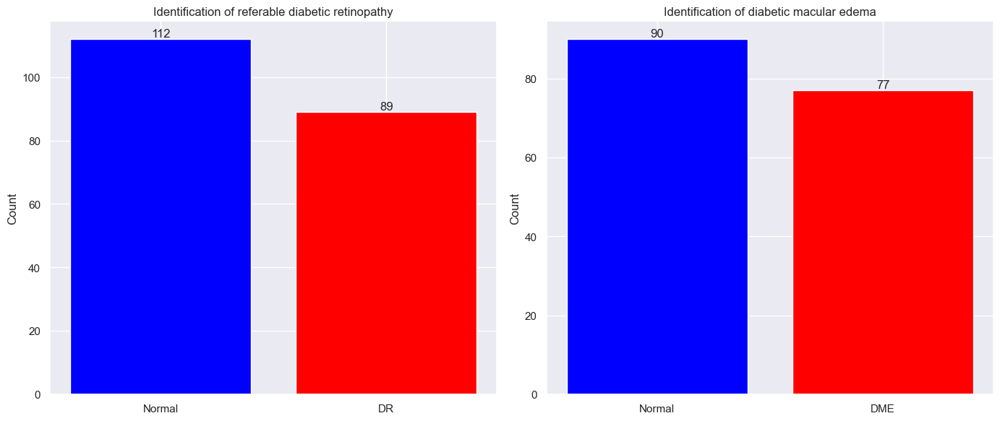

In [3]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the data
df = pd.read_csv('data/labels/1. Training.csv')

# Extract the counts for the second column
second_col_counts = df.iloc[:, 1].value_counts()

# Exclude NaN values and count occurrences for the third column
filtered_third_col = df.iloc[:, 2].dropna().astype(int)
third_col_counts = filtered_third_col.value_counts()

# Plot the counts for the second column
plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
bars1 = plt.bar(second_col_counts.index.astype(str), second_col_counts.values, color=['blue', 'red'])
plt.ylabel('Count')
plt.xticks([0, 1], ['Normal', 'DR'])
plt.title('Identification of referable diabetic retinopathy')
# Add counts on bars
for bar in bars1:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom')

# Plot the counts for the third column
plt.subplot(1, 2, 2)
bars2 = plt.bar(third_col_counts.index.astype(str), third_col_counts.values, color=['blue', 'red'])
plt.ylabel('Count')
plt.xticks([0, 1], ['Normal', 'DME'])

# Add counts on bars
for bar in bars2:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), ha='center', va='bottom')
plt.title('Identification of diabetic macular edema')

plt.tight_layout()
plt.show()


In [4]:
dataset = ds.CustomImageDataset('data/labels/1. Training.csv', 'data/images/1. Training', transform=transform)

In [5]:
from collections import Counter
from torch.utils.data import DataLoader
print( experimental)
transform = grid_search_transform(IMAGE_SIZE, 
                          use_center_crop='circular', 
                          gaussian_sigma=None, 
                          aug=False,
                          tile_size=8)
# Assuming you have a dataset and DataLoader
dataset = ds.CustomImageDataset('data/labels/1. Training.csv', 'data/images/1. Training', transform=transform[0])
label_counts = Counter(target for _, target in dataset)
print(label_counts)

Compose(
    Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)
Compose(
    Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
) Compose(
    Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)
Counter({1.0: 112, 0.0: 89})


Original image shape: torch.Size([3, 246, 246])
Original image shape: torch.Size([3, 246, 246])
Original image shape: torch.Size([3, 246, 246])


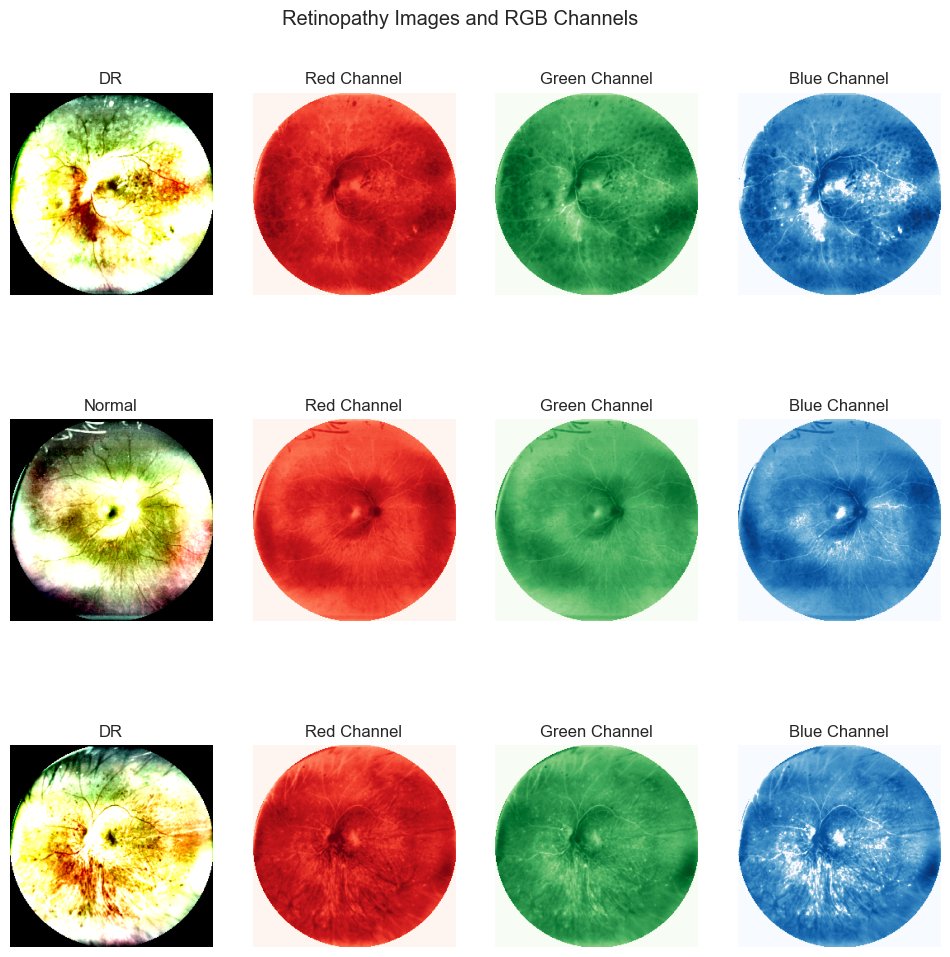

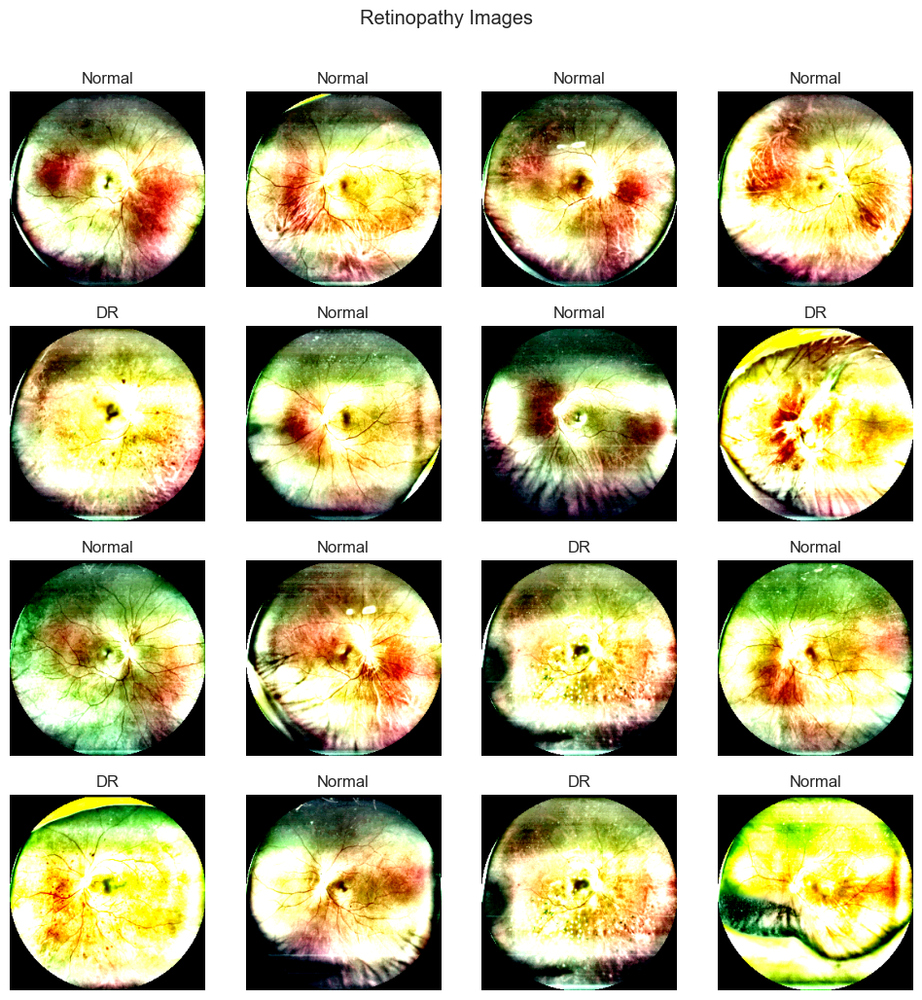

In [6]:
rows = 3
vis.visualize_RGB(dataset=dataset, rows=rows)
vis.visualize_data(dataset=dataset, hist=False)

In [7]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size = BATCH_SIZE,
                                          shuffle = True)

In [8]:
from torchmetrics.classification import BinaryAccuracy, F1Score, AUROC, Precision, Recall
import torch

In [9]:
accuracy       = BinaryAccuracy()
f1_score       = F1Score(num_classes=1, task='binary', average='none')
aucroc         = AUROC(num_classes=1, task='binary')
precision      = Precision(num_classes=1, task='binary', average='none')
recall         = Recall(num_classes=1, task='binary', average='none')

In [10]:
y = torch.tensor([1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0])
p = torch.tensor([1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

In [11]:
c_accuracy        = accuracy(p, y)
c_f1_score        = f1_score(p, y)
c_aucroc          = aucroc(p, y)
c_precision       = precision(p, y)
c_recall          = recall(p, y)

In [12]:
print(
    f"""
accuracy  = {c_accuracy}
f1_score  = {c_f1_score}
aucroc    = {c_aucroc}
precision = {c_precision}
recall    = {c_recall}
    """
)


accuracy  = 0.53125
f1_score  = 0.6938775777816772
aucroc    = 0.44736841320991516
precision = 0.5666666626930237
recall    = 0.8947368264198303
    


In [13]:
c_accuracy        = accuracy(y, p)
c_f1_score        = f1_score(y, p)
c_aucroc          = aucroc(y, p)
c_precision       = precision(y, p)
c_recall          = recall(y, p)

In [14]:
print(
    f"""
accuracy  = {c_accuracy}
f1_score  = {c_f1_score}
aucroc    = {c_aucroc}
precision = {c_precision}
recall    = {c_recall}
    """
)


accuracy  = 0.53125
f1_score  = 0.6938775777816772
aucroc    = 0.28333333134651184
precision = 0.8947368264198303
recall    = 0.5666666626930237
    


In [15]:
c_precision=1.0
c_recall=0.2194230854511261

In [16]:
print(2 * (c_recall * c_precision) / (c_recall + c_precision))

0.35988015655772243


In [17]:
print(IMAGE_SIZE)

256


In [18]:
print(torch.cuda.is_available())

False


In [19]:
InterruptedError()

InterruptedError()

In [20]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

for i in range(34,51): # Load an image
img = cv2.imread(rf'data\images\2. Validation\uwf4dr_rdr_dme_val_{i}.jpg')
img = cv2.resize(img, (255, 255))

# Split the image into its respective Blue, Green, Red channels
blue_channel, green_channel, red_channel = cv2.split(img)

# Display each channel
plt.figure(figsize=(12, 4))

# Display the Blue channel
plt.subplot(1, 3, 1)
plt.imshow(blue_channel, cmap='gray')
plt.title("Blue Channel")
plt.grid(False) 

# Display the Green channel
plt.subplot(1, 3, 2)
plt.imshow(green_channel, cmap='gray')
plt.title("Green Channel")
plt.grid(False) 

# Display the Red channel
plt.subplot(1, 3, 3)
plt.imshow(red_channel, cmap='gray')
plt.title("Red Channel")
plt.grid(False) 

plt.show()


IndentationError: expected an indented block after 'for' statement on line 5 (2146770968.py, line 6)

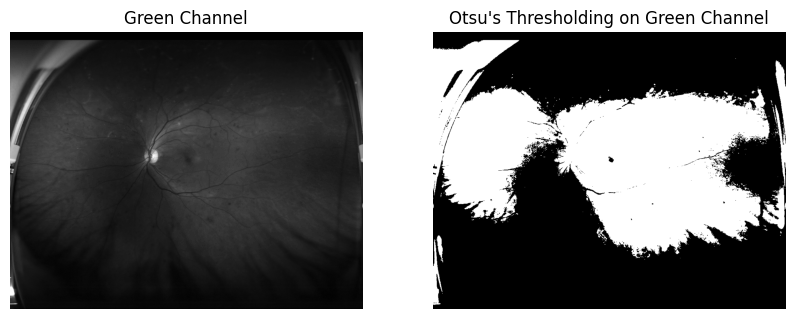

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Load the image
img = cv2.imread(r'data\images\2. Validation\uwf4dr_rdr_dme_val_40.jpg')

# Extract the green channel
green_channel = img[:, :, 1]

# Apply Otsu's thresholding
_, otsu_thresh = cv2.threshold(green_channel, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Display the original green channel and Otsu's thresholding result
plt.figure(figsize=(10, 5))

# Show the green channel
plt.subplot(1, 2, 1)
plt.imshow(green_channel, cmap='gray')
plt.title("Green Channel")
plt.axis('off')

# Show the Otsu's thresholding result
plt.subplot(1, 2, 2)
plt.imshow(otsu_thresh, cmap='gray')
plt.title("Otsu's Thresholding on Green Channel")
plt.axis('off')

plt.show()


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def elliptical_crop(image, axes=None):
    # Create a mask with the same dimensions as the image
    mask = np.zeros_like(image, dtype=np.uint8)
    center = (image.shape[1] // 2, image.shape[0] // 2)
    axes = (center[0]-30, center[1]-30)

    # Draw the ellipse on the mask
    cv2.ellipse(mask, center, axes, 0, 0, 360, (255, 255, 255), thickness=-1)

    # Apply the mask to the image
    elliptical_cropped_img = cv2.bitwise_and(image, mask)

    return elliptical_cropped_img

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
def detection(path, value):
    # Load the image
    img = cv2.imread(path)

    # Extract the green channel
    img = img[:, :, 1]
    img = elliptical_crop(img)

    # Gamma correction
    img = np.array(img)
    img = img / 255.0
    img = np.power(img, 0.5)
    img = np.uint8(img * 255)

    params = cv2.SimpleBlobDetector_Params()
    params.filterByArea = True
    params.minArea = 10
    params.maxArea = 300

    params.filterByCircularity = False

    detector = cv2.SimpleBlobDetector_create(params)

    keypoints = detector.detect(img)

    img_with_keypoints = cv2.drawKeypoints(img, keypoints, np.array([]), (0, 0, 255),
                                        cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    # Display the image with detected blobs
    plt.imshow(img_with_keypoints, cmap='gray')
    plt.title(f"{path} / {value} Detected Blobs: {len(keypoints)} blobs found")
    plt.axis('off')
    plt.show()


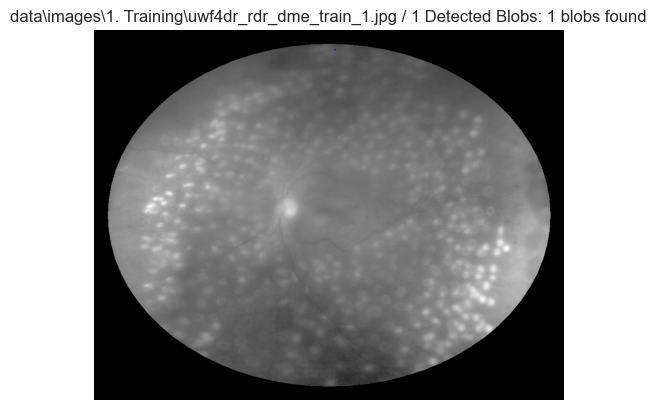

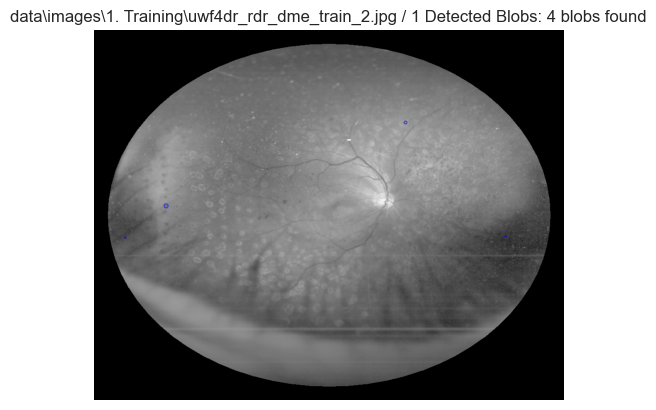

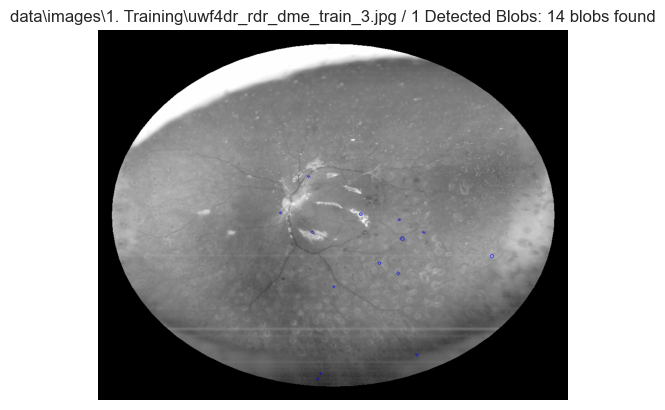

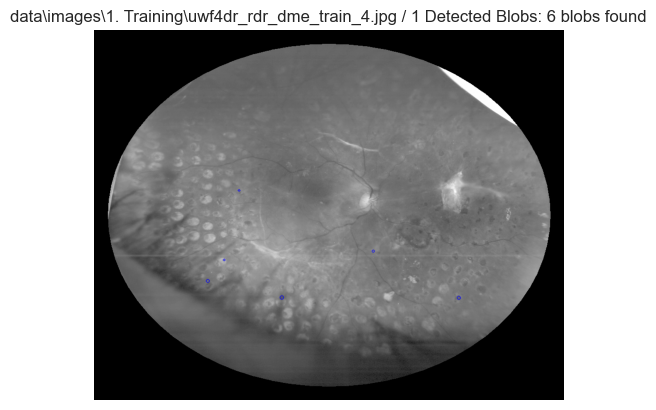

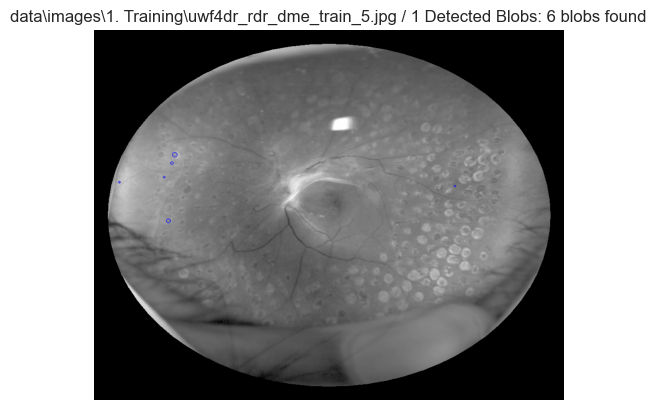

...

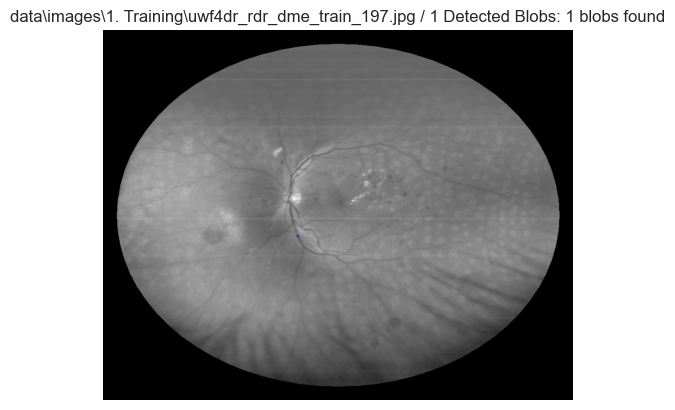

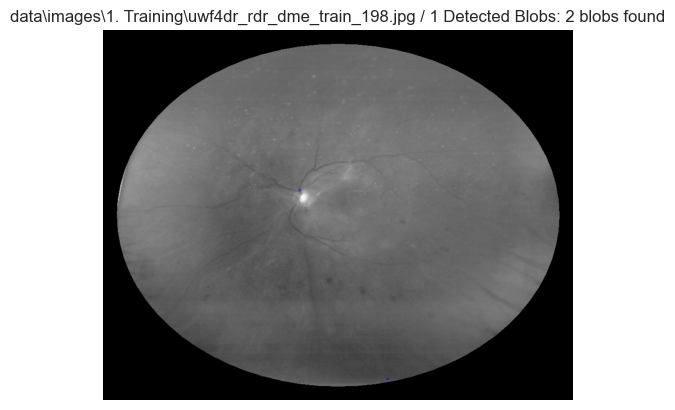

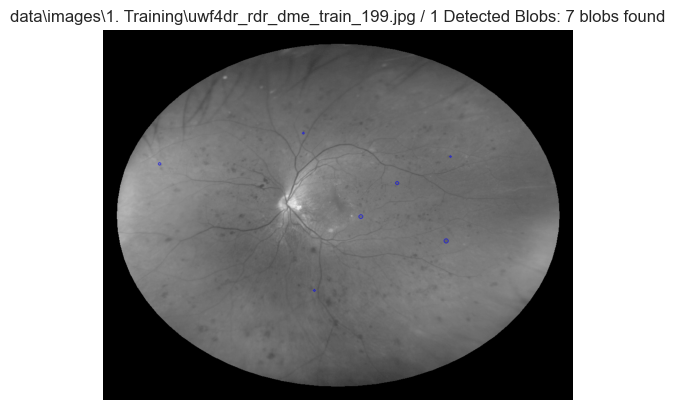

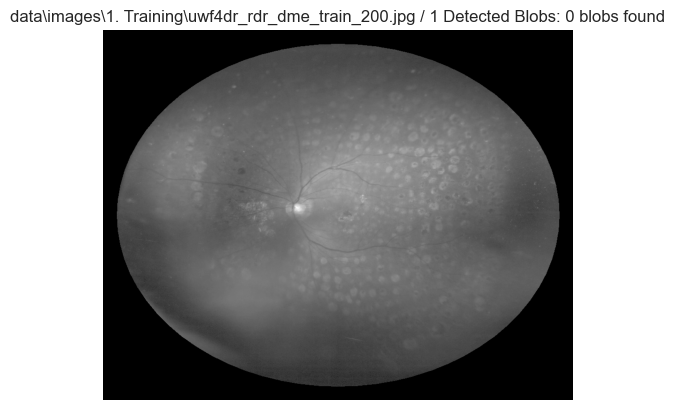

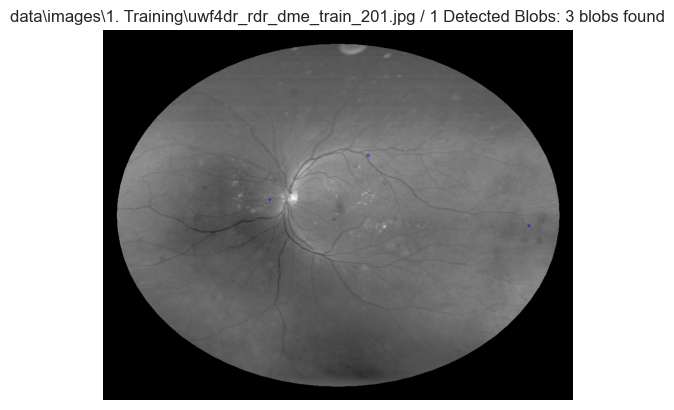

In [ ]:
df = pd.read_csv(r'data\labels\2. Validation.csv')
df = pd.read_csv(r'data\labels\1. Training.csv')
df.set_index('image', inplace=True)

for i in range(1, 202):
    title  = f'uwf4dr_rdr_dme_train_{i}.jpg'
    path    = fr'data\images\2. Validation\{title}'
    path    = fr'data\images\1. Training\{title}'
    value = df.loc[title, 'referable diabetic retinopathy']

    detection(path, value)

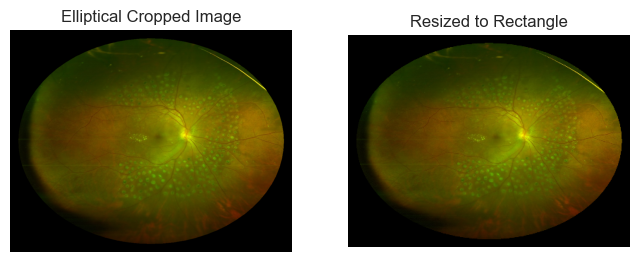

In [ ]:
def resize_to_rectangle(elliptical_img, canvas_size):
    # Get the size of the elliptical image
    height, width = elliptical_img.shape[:2]

    # Create a blank canvas with the specified size
    canvas = np.zeros((canvas_size[1], canvas_size[0], 3), dtype=np.uint8)

    # Resize elliptical image to fit within the canvas dimensions
    resized_img = cv2.resize(elliptical_img, (canvas_size[0], canvas_size[1]), interpolation=cv2.INTER_LINEAR)

    # Place the resized elliptical image onto the canvas
    canvas[:resized_img.shape[0], :resized_img.shape[1]] = resized_img

    return canvas

# Load the elliptical cropped image
img = cv2.imread(r'data\images\2. Validation\uwf4dr_rdr_dme_val_20.jpg')
elliptical_cropped_img = elliptical_crop(img)

# Define the size of the rectangular canvas
canvas_size = (400, 300)  # width, height

# Resize the elliptical image to fit the canvas
rectangular_img = resize_to_rectangle(elliptical_cropped_img, canvas_size)

# Display the result
plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.title('Elliptical Cropped Image')
plt.imshow(cv2.cvtColor(elliptical_cropped_img, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Resized to Rectangle')
plt.imshow(cv2.cvtColor(rectangular_img, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.show()

Compose(
    Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
) Compose(
    Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
    RandomHorizontalFlip(p=0.5)
    RandomVerticalFlip(p=0.5)
    RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
)
Compose(
    Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
) Compose(
    Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
    RandomHorizontalFlip(p=0.5)
    RandomVerticalFlip(p=0.5)
    RandomRotation(degrees=[-30.0, 30.0], interpolation=nearest, expand=False, fill=0)
    ToTensor()
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 

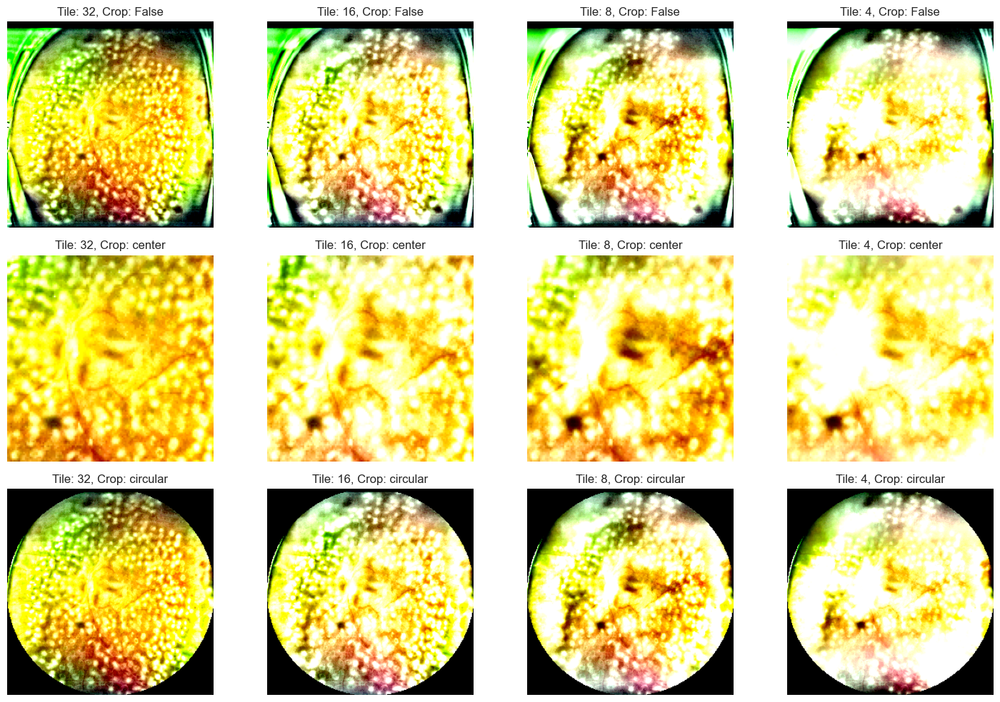

In [27]:
import torchvision.transforms as transforms 

image = Image.open('data/images/1. Training/uwf4dr_rdr_dme_train_1.jpg')

tile_sizes = [32, 16, 8, 4]
use_center_crop_options = [False, 'center', 'circular']

def apply_transformations(img, tile_size, center_crop_option):
    # Use the grid_search_transform function provided
    transforms_list = grid_search_transform(
        image_size=IMAGE_SIZE, 
        use_center_crop=center_crop_option, 
        tile_size=tile_size
    )
    return transforms_list[0](img)  # Apply the original transformation

# Plotting setup
fig, axes = plt.subplots(len(use_center_crop_options), len(tile_sizes), figsize=(15, 10))

for i, crop_option in enumerate(use_center_crop_options):
    for j, tile_size in enumerate(tile_sizes):
        # Apply transformation to the image
        transformed_img = apply_transformations(image, tile_size, crop_option)
        
        # Convert the image from Tensor to numpy array for visualization
        transformed_img_np = np.transpose(transformed_img.numpy(), (1, 2, 0))  # (C, H, W) -> (H, W, C)
        transformed_img_np = np.clip(transformed_img_np, 0, 1)  # Ensure valid image range for plotting
        
        # Plot the transformed image
        ax = axes[i, j]
        ax.imshow(transformed_img_np)
        ax.set_title(f"Tile: {tile_size}, Crop: {crop_option}")
        ax.axis("off")

plt.tight_layout()
plt.show()
